In [1]:
import cufflinks as cf
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
#cf.getThemes()
#cf.colors.scales()
#cf.set_config_file(theme='pearl', colorscales='')
cf.go_offline()

In [3]:
df = pd.read_csv(r'Datasets\911.csv')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 627057 entries, 0 to 627056
Data columns (total 9 columns):
lat          627057 non-null float64
lng          627057 non-null float64
desc         627057 non-null object
zip          550638 non-null float64
title        627057 non-null object
timeStamp    627057 non-null object
twp          626788 non-null object
addr         627057 non-null object
e            627057 non-null int64
dtypes: float64(3), int64(1), object(5)
memory usage: 43.1+ MB


In [5]:
df.head()

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1


In [6]:
df['zip'].value_counts()

19401.0    42731
19464.0    41266
19403.0    32831
19446.0    30429
19406.0    21301
           ...  
19456.0        1
19457.0        1
18080.0        1
19543.0        1
8077.0         1
Name: zip, Length: 195, dtype: int64

In [7]:
df['twp'].value_counts()

LOWER MERION       52791
ABINGTON           37783
NORRISTOWN         35184
UPPER MERION       34307
CHELTENHAM         28916
                   ...  
EAST GREENVILLE     1239
BRYN ATHYN          1179
GREEN LANE           374
PHILA COUNTY         252
LEHIGH COUNTY        172
Name: twp, Length: 68, dtype: int64

In [8]:
len(df['title'].unique())

147

In [9]:
df['Reason'] = df['title'].apply(lambda title: title.split(':')[0])

In [10]:
df['Reason'].iplot(kind='hist')

In [11]:
df['Reason'].value_counts()

EMS        312615
Traffic    220573
Fire        93869
Name: Reason, dtype: int64

In [12]:
df['timeStamp'] = pd.to_datetime(df['timeStamp'])

In [13]:
time = df['timeStamp'].iloc[0]
time.hour

17

In [14]:
df['Hour'] = df['timeStamp'].apply(lambda time: time.hour)

In [15]:
df['Month'] = df['timeStamp'].apply(lambda time: time.month)

In [16]:
df['Day of week'] = df['timeStamp'].apply(lambda time: time.dayofweek)

dmap = {0:'Mon', 1:'Tue', 2:'Wed', 3:'Thu', 5:'Sat', 6:'Sun'}
df['Day of week'] = df['Day of week'].map(dmap)

In [17]:
df.head(5)

,lat,lng,desc,zip,title,timeStamp,twp,addr,e,Reason,Hour,Month,Day of week
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1,EMS,17,12,Thu
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1,EMS,17,12,Thu
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1,Fire,14,12,Thu
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1,EMS,16,12,Thu
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1,EMS,16,12,Thu


In [18]:
df['Day of week'].iplot(kind='hist')

In [19]:
df['Month'].iplot(kind='hist', bins=12)

In [20]:
byMonth = df.groupby('Month').count()

In [21]:
byMonth

,lat,lng,desc,zip,title,timeStamp,twp,addr,e,Reason,Hour,Day of week
Month,,,,,,,,,,,,
1,62336,62336,62336,55294,62336,62336,62312,62336,62336,62336,62336,53027
2,55427,55427,55427,48922,55427,55427,55405,55427,55427,55427,55427,47172
3,60027,60027,60027,53252,60027,60027,60001,60027,60027,60027,60027,49086
4,48050,48050,48050,42233,48050,48050,48036,48050,48050,48050,48050,40824
5,48467,48467,48467,42257,48467,48467,48443,48467,48467,48467,48467,41253
6,48493,48493,48493,42223,48493,48493,48466,48493,48493,48493,48493,40846
7,49571,49571,49571,43405,49571,49571,49550,49571,49571,49571,49571,42468
8,48359,48359,48359,42311,48359,48359,48335,48359,48359,48359,48359,41023
9,47213,47213,47213,41289,47213,47213,47196,47213,47213,47213,47213,39519


In [22]:
t = df['timeStamp'].iloc[0]

In [23]:
df['Date'] = df['timeStamp'].apply(lambda t:t.date())

In [24]:
df.head()

,lat,lng,desc,zip,title,timeStamp,twp,addr,e,Reason,Hour,Month,Day of week,Date
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1,EMS,17,12,Thu,2015-12-10
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1,EMS,17,12,Thu,2015-12-10
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1,Fire,14,12,Thu,2015-12-10
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1,EMS,16,12,Thu,2015-12-10
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1,EMS,16,12,Thu,2015-12-10


In [25]:
df.groupby('Date').count()['lat'].iplot()

In [26]:
df[df['Reason']=='Traffic'].groupby('Date').count()['lat'].iplot(title='Traffic Calls')

In [27]:
df[df['Reason']=='Fire'].groupby('Date').count()['lat'].iplot(title='Fire Calls')

In [28]:
df[df['Reason']=='EMS'].groupby('Date').count()['lat'].iplot(title='EMS Calls')

In [29]:
dayHour = df.groupby(by=['Day of week', 'Hour']).count()['Reason'].unstack()

In [30]:
dayMonth = df.groupby(by=['Day of week', 'Month']).count()['Reason'].unstack()

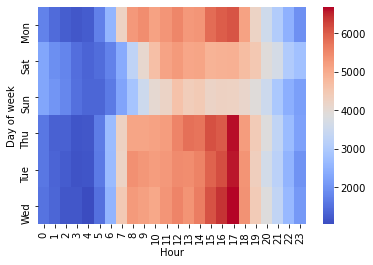

In [31]:
sns.heatmap(dayHour, cmap='coolwarm')

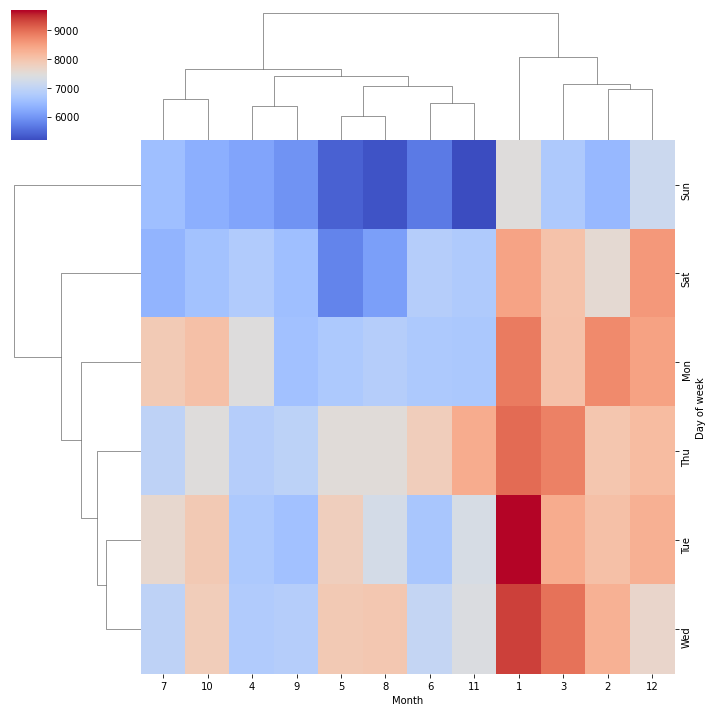

In [32]:
sns.clustermap(dayMonth, cmap='coolwarm')